In [1]:
import scipy.io.wavfile as wavfile
from IPython.display import Audio
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

In [239]:
# уменьшение амплитуды краёв блока

def slope(block):
    return block*np.sin(0.5*np.pi*np.sin((np.linspace(0,len(block)-1,len(block))+0.5)/len(block)*np.pi)**2)

In [594]:
# модифицированное дискретное косинусное преобразование

def mdct(block):
    out = np.zeros(len(block)//2)
    n = np.linspace(0,len(block)-1,len(block))
    for i in range(len(block)//2):
        out[i] = np.sum(block*np.cos(np.pi/(len(block)/2)*(n+0.5+len(block)/2/2)*(i+0.5)))
    return out

In [241]:
# обратное модифицированное дискретное косинусное преобразование

def imdct(block):
    out = np.zeros(len(block)*2)
    k = np.linspace(0,len(block)-1,len(block))
    for i in range(len(block)*2):
        out[i] = 2/(len(block))*np.sum(block*np.cos(np.pi/len(block)*(i+0.5+len(block)/2)*(k+0.5)))
    return out

In [242]:
# сплайнирование стыков блоков

def spline(sub_sig):
    x = []
    y = []
    for i in range(10,15):
        x.append(i)
        y.append(sub_sig[i])
    for i in range(25,30):
        x.append(i)
        y.append(sub_sig[i])
    x.append(20)
    y.append(sub_sig[20])
    min_y, max_y = min(y), max(y)
    min_x, max_x = min(x), max(x)
    x = (np.array(x)-min_x)/(max_x-min_x)
    y = (np.array(y)-min_y)/(max_y-min_y)
    A = np.zeros([11,11])
    B = np.zeros([11,1])
    B[:,0] = y[:]
    for i in range(11):
        A[:,10-i] = x**i
    a = np.matmul(np.linalg.pinv(A),B)
    out = {}
    for i in range(10,30):
        x_out = (i-min_x)/(max_x-min_x)
        y_out = 0
        for j in range(11):
            y_out += (x_out**j)*a[10-j,0]
        out[i] = y_out*(max_y-min_y)+min_y
    for i in range(10,30):
        sub_sig[i] = out[i]
    return sub_sig

In [616]:
# Вейвлет-преобразование сигнала на заданное количество уровней (каждый следующий уровнь уменьшает размер сигнала в 2 раза)
# Здесь использован вейвлет Добеши 10 порядка

def wavelet(spec, level = 3):
    spec_len = len(spec)

    end = 10

    x = [[]]*level
    len_x = []

    h = [0.026670057900950818,0.18817680007762133,0.5272011889309198,0.6884590394525921,0.2811723436604265,
                -0.24984642432648865,-0.19594627437659665,0.12736934033574265,0.09305736460380659,-0.07139414716586077,
                -0.02945753682194567,0.03321267405893324,0.0036065535669883944,-0.010733175482979604,0.0013953517469940798,
                0.00199240529499085,-0.0006858566950046825,-0.0001164668549943862,9.358867000108985e-05,-1.326420300235487e-05]
    g = [-1.326420300235487e-05,-9.358867000108985e-05,-0.0001164668549943862,0.0006858566950046825,0.00199240529499085,
                -0.0013953517469940798,-0.010733175482979604,-0.0036065535669883944,0.03321267405893324,0.02945753682194567,
                -0.07139414716586077,-0.09305736460380659,0.12736934033574265,0.19594627437659665,-0.24984642432648865,
                -0.2811723436604265,0.6884590394525921,-0.5272011889309198,0.18817680007762133,-0.026670057900950818]

    a = [[]]*level
    c = [[]]*level

    L = []

    x[0] = np.zeros(((spec_len+39)//2)*2+end);
    x[0][19:spec_len+19] = spec[:]
    x[0][0:19] = x[0][19];
    x[0][spec_len+19:] = x[0][spec_len+19-1];

    #  ///////////////////////////////////LEVEL 1 to n//////////////////////////////////////////////
    for ii in range(level):
        len1 = ((len(x[ii])//2+39)//2)*2+end
        len2 = len(x[ii])//2
        len_x.append(len(x[ii]))
        L.append(len2)

        a[ii] = np.zeros(len1)
        c[ii] = np.zeros(len1)
        for i in range(len2):
            a[ii][i+19] = 0;
            c[ii][i+19] = 0;
            for j in range(20):
                a[ii][i+19] += h[j]*x[ii][(2*i+j)%(len(x[ii]))]
                c[ii][i+19] += g[j]*x[ii][(2*i+j)%(len(x[ii]))]

        a[ii][0:19] = a[ii][19]
        c[ii][0:19] = c[ii][19]

        a[ii][len2+19:] = a[ii][len2+18]
        c[ii][len2+19:] = c[ii][len2+18]

        #c[ii][:] = 0

        if  ii < level-1:
            x[ii+1] = a[ii][:]

    return a[-1][:], (L, len_x, spec_len)



In [624]:
# Обратное вейвлет-преобразование

def inverse_wavelet(spec, params, level = 3):
    L, len_x, spec_len = params[0], params[1], params[2]
      #/////////////////////////////////RECONSTRUCTION/////////////////////////////////////////
    A = np.zeros([level,spec_len])
    y = [[]]*level
        
    h = [0.026670057900950818,0.18817680007762133,0.5272011889309198,0.6884590394525921,0.2811723436604265,
                -0.24984642432648865,-0.19594627437659665,0.12736934033574265,0.09305736460380659,-0.07139414716586077,
                -0.02945753682194567,0.03321267405893324,0.0036065535669883944,-0.010733175482979604,0.0013953517469940798,
                0.00199240529499085,-0.0006858566950046825,-0.0001164668549943862,9.358867000108985e-05,-1.326420300235487e-05]
    g = [-1.326420300235487e-05,-9.358867000108985e-05,-0.0001164668549943862,0.0006858566950046825,0.00199240529499085,
                -0.0013953517469940798,-0.010733175482979604,-0.0036065535669883944,0.03321267405893324,0.02945753682194567,
                -0.07139414716586077,-0.09305736460380659,0.12736934033574265,0.19594627437659665,-0.24984642432648865,
                -0.2811723436604265,0.6884590394525921,-0.5272011889309198,0.18817680007762133,-0.026670057900950818]

    #/////////////////////////////////RECONSTRUCTION/////////////////////////////////////////
    #for kk in range(level):
    kk = level - 1
    for ii in reversed(range(kk+1)): 

        len1 = L[ii]
        len2 = len_x[ii]
        y[ii] = np.zeros(len2)

        for i in range(len1):
            for j in range(10):
                k = i+j
                if ii == kk:
                    y[ii][2*i] += h[18-j*2]*spec[k]
                    y[ii][2*i+1] += h[19-j*2]*spec[k]
                else:
                    y[ii][2*i] += h[18-j*2]*y[ii+1][k]
                    y[ii][2*i+1] += h[19-j*2]*y[ii+1][k]      


        y[ii][0:19] = y[ii][19]

        y[ii][20:-20] = y[ii][40:]

    A[kk][:] = y[0][19:19+spec_len]
    return A[kk][:]

In [625]:
# Пример работы

In [626]:
# Загружаем звуковой файл - возьмите, пожалуйста, люблой wav или flac, скачайте где-нибудь
filename = 'Michael Jackson - Billie Jean.wav'
sample_rate, samples = wavfile.read(filename)

In [627]:
# Если сигнал имеет 2 дорожки

signal = samples[:,0]

In [628]:
Audio(signal, rate=sample_rate)

In [649]:
# Пример работы с функциями

# Вырезаем 1 блок длиной 2048 каналов

block = signal[225000:225000+2048]

# Применяем функцию slope

block = slope(block)

# Вычисляем спектр с помощью MDCT

block_mdct = mdct(block)

# Далее спектр мы можем сжать с помощью вейевлета Добеши - чем выше уровень, тем короче сигнал

block_mdct_wavelet, params = wavelet(block_mdct, 2)

# block_mdct_wavelet - это то, что мы сохраняем в файл - сжатый сигнал

# Далее - восстановление вейвлета
block_mdct_wavelet_inverse = inverse_wavelet(block_mdct_wavelet, params, 2)

# Далее - восстановление MDCT
block_final = imdct(block_mdct_wavelet_inverse)


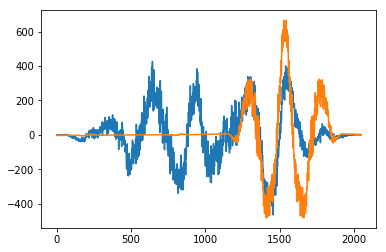

In [650]:
# Сравнение - при восстановлении берётся вторая половина блока

plt.plot(block)
plt.plot(block_final)